In [24]:
import re
import os 
import sys 

from os import listdir
from os.path import isfile, join
import numpy as np
import matplotlib.pyplot as plt
import skimage
from skimage import io

import matplotlib
from pathlib import Path
from tqdm.notebook import trange, tqdm
from joblib import Parallel, delayed
import re
from skimage import exposure
import h5py
import pandas as pd
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from functools import reduce
from collections import defaultdict
import pickle
import seaborn as sns
from skimage.segmentation import mark_boundaries
from sklearn.neighbors import NearestNeighbors
from sklearn.metrics.pairwise import paired_distances

In [25]:
p_dir = (Path().cwd().parents[0]).absolute()
data_dir = p_dir / 'data' 

In [26]:
%load_ext autoreload
%autoreload 2

module_path = str(p_dir / "src")

if module_path not in sys.path:
    sys.path.append(module_path)

import utils as my_utils

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [27]:
donor = 'Donor E'
h5_data = p_dir / 'data' / 'h5' / f'{donor}.hdf5'


# Import data

data = {'data': df, 'embeddings': embeddings, 'clusters': clustering_labels, 'markers': markers, 'tol':tol, 'count': df_count, 'label2cluster':label2cluster}

In [28]:
# Read mask image
def get_masks(mask_folder):
    '''
    Function to get all mask from mask forlder
    '''
    # Read masks
    masks = {}

    for (dirpath, dirnames, filenames) in os.walk(mask_folder):
        for name in sorted(filenames):
            if "tif" in name:
                filename = os.path.join(dirpath, name)
                img = skimage.io.imread(filename)
                condition = name.split('_')[-1].split('.')[0]
                masks[condition] = img
            else:
                continue
    return masks
    

def get_imgs(file_path, name):
    f = h5py.File(file_path, 'r')
    imgs = f[name]
    labels = list(f[name].attrs['labels'])
    return imgs, labels


In [29]:
df = pd.read_csv(data_dir / 'metadata' / f"info_{donor}.csv")
ROIs = df.ROI.unique()
masks = get_masks(data_dir / 'masks' / donor)

In [30]:
file = data_dir / 'metadata'/ f'{donor}_all.pickle'

with open(file, 'rb') as handle:
    data = pickle.load(handle)

In [31]:
df = data['data']
embeddings = data['embeddings']
clusters = data['clusters']
markers = data['markers']
tol = data['tol']
df_count = data['count']
label2cluster = data['label2cluster']
my_cmap_row = data['cmap']

In [32]:
roi = 2
roi_df = df[df.ROI == roi]
roi_index = roi_df.index.tolist()
roi_embeddings = embeddings[roi_index]
roi_labels = list(map(clusters.__getitem__, roi_index))
roi_labels = list(map(label2cluster.get, roi_labels))

# Read marker images and masks
imgs, markers = get_imgs(h5_data, str(roi))
mask = masks[str(roi)]
img_background = imgs[-1]

# Mutliplex images

In [33]:
def contrast_streching(img, n_min=0, n_max=75):
    p2, p98 = np.percentile(img, (n_min, n_max))
    return exposure.rescale_intensity(img, in_range=(p2, p98))

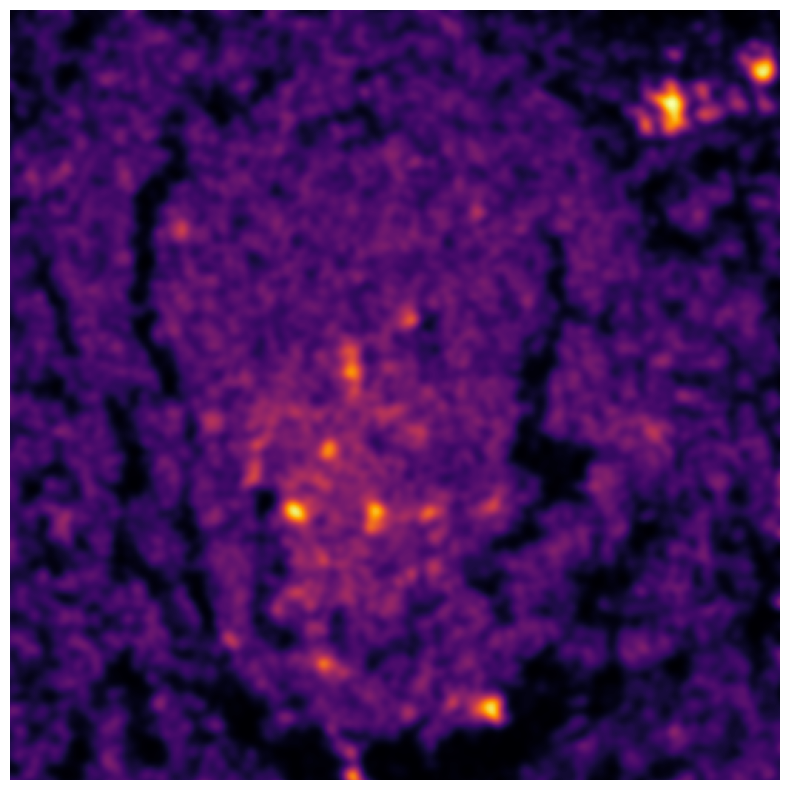

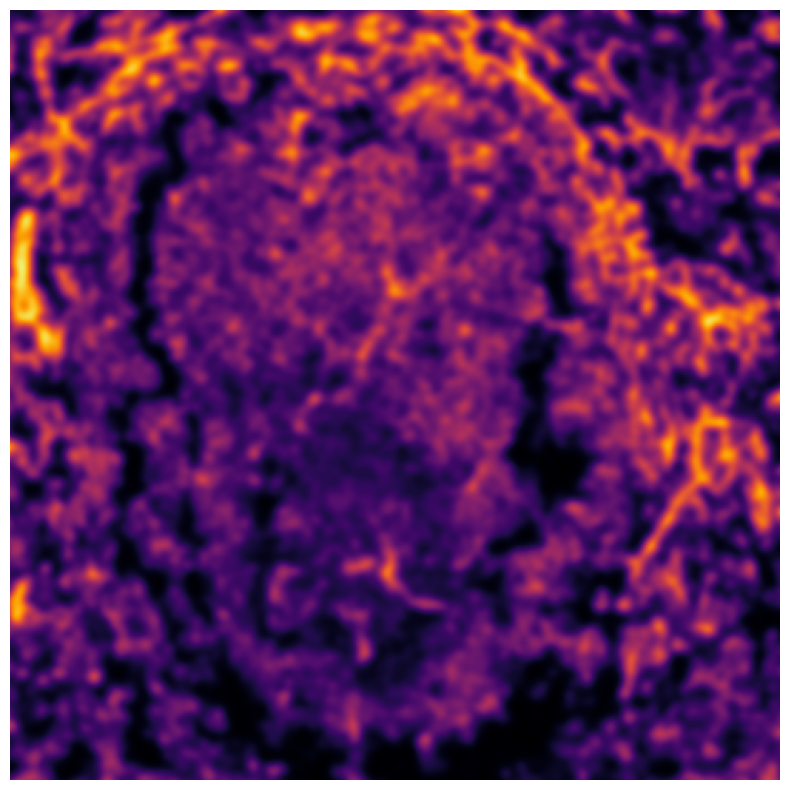

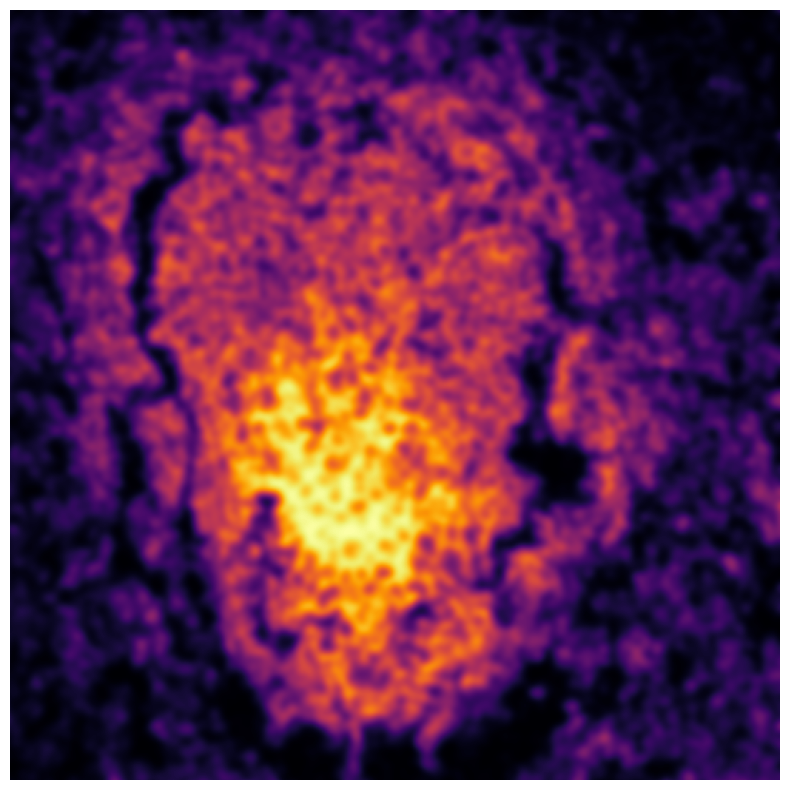

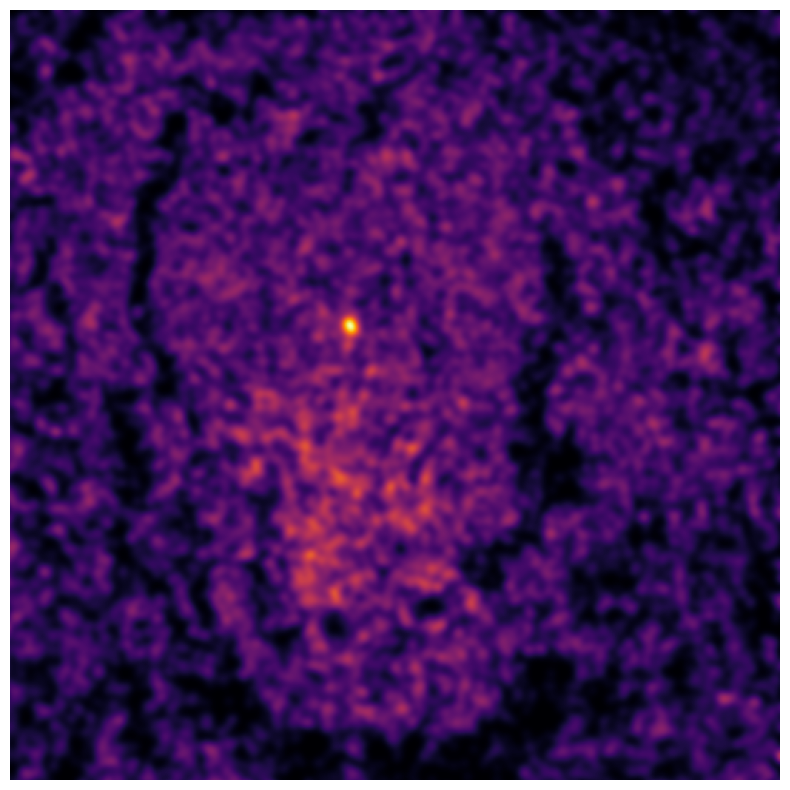

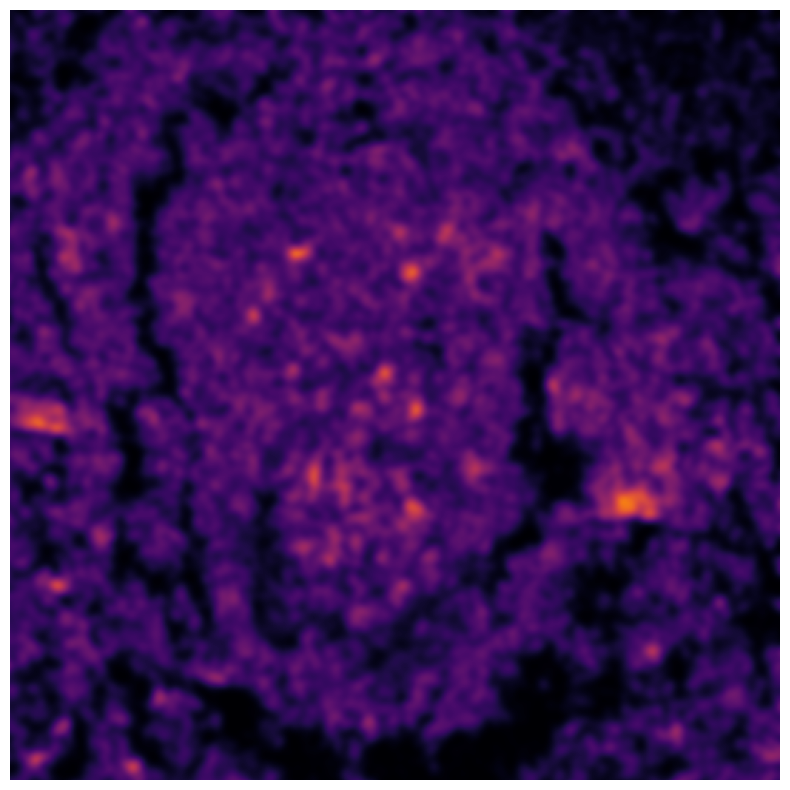

...

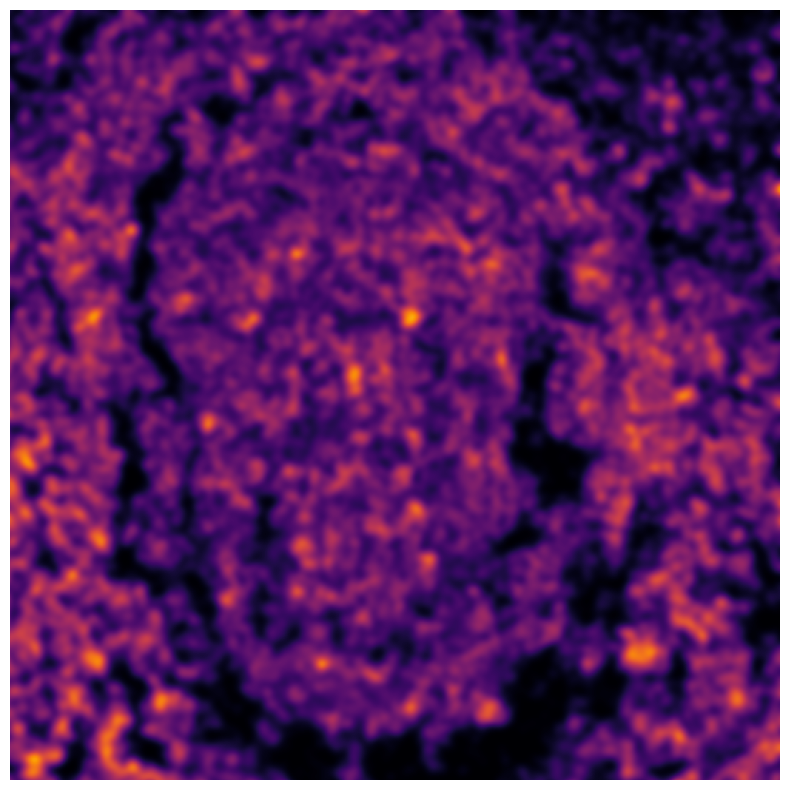

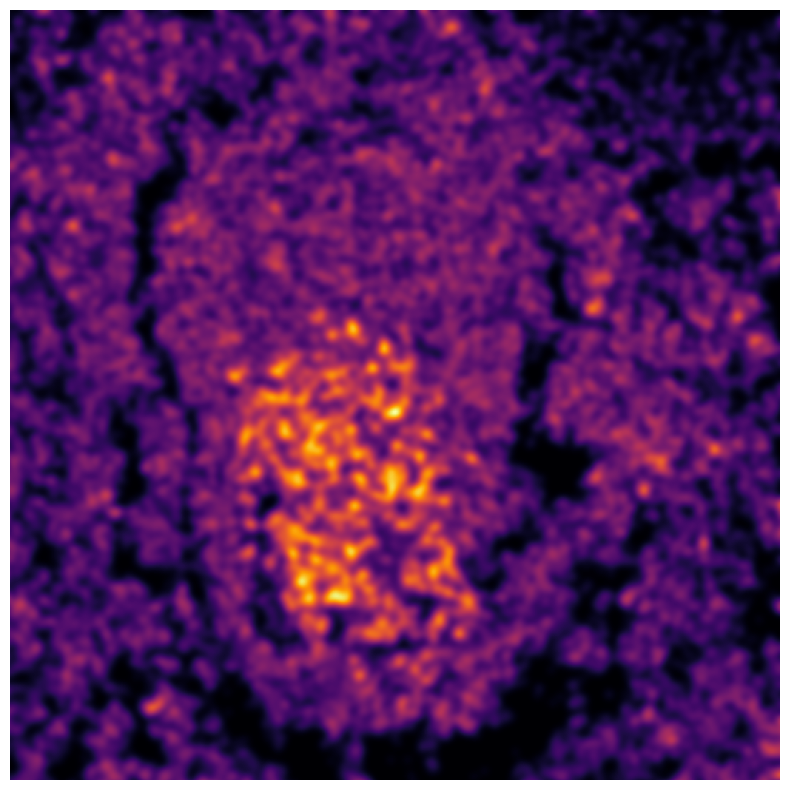

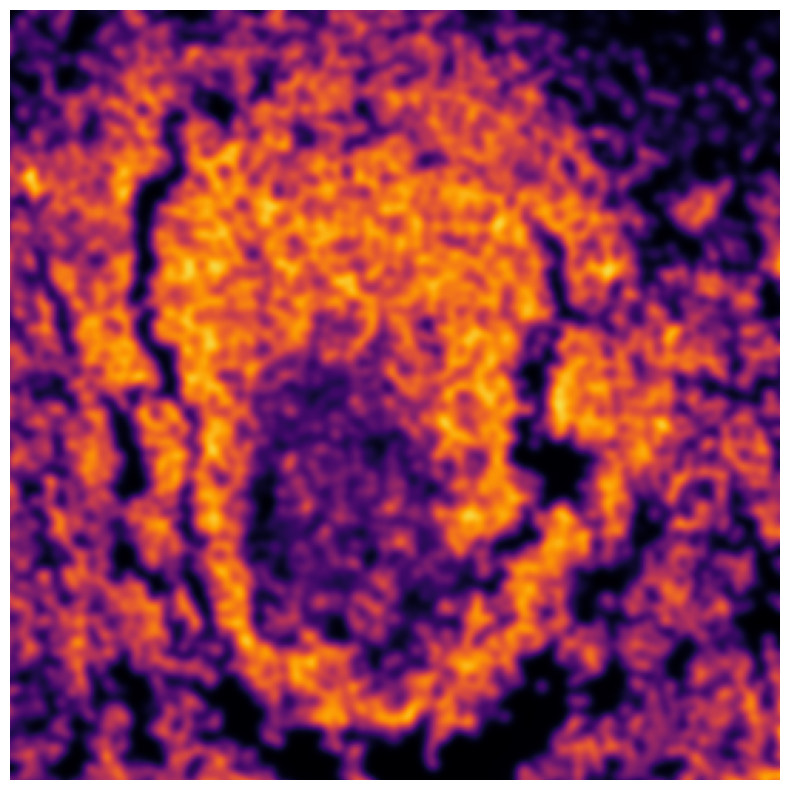

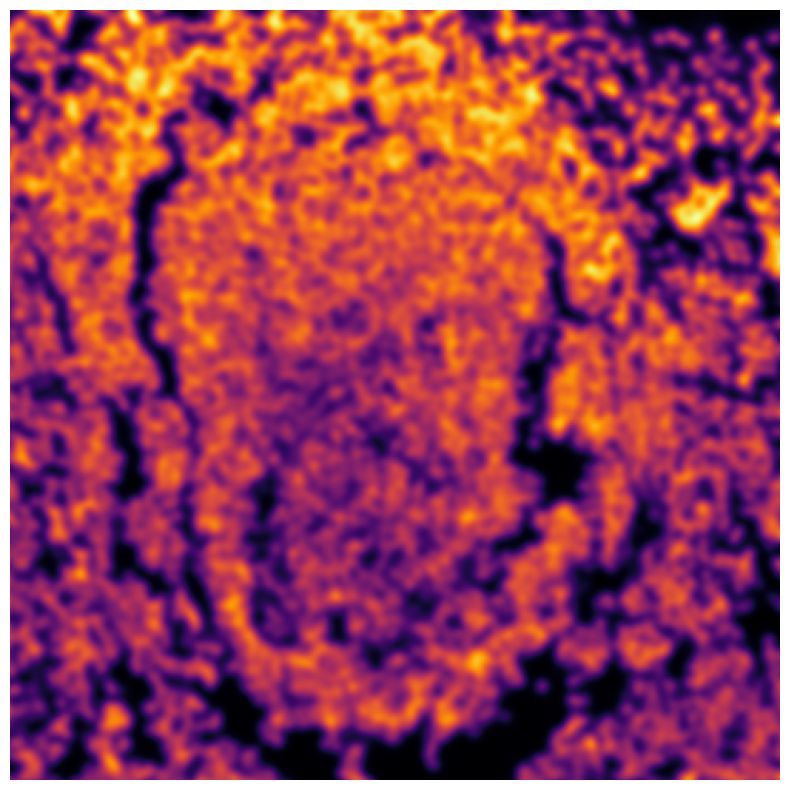

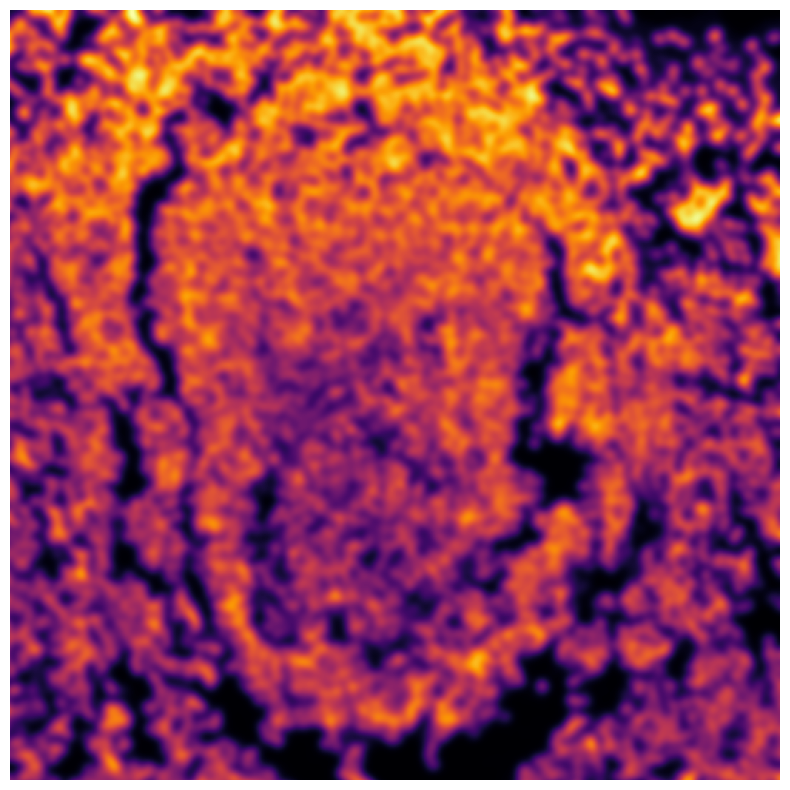

In [55]:
from skimage.filters import gaussian

for img in imgs:
    fig, ax = plt.subplots(figsize=(10,10))
    ax.imshow(gaussian(contrast_streching(img, n_min=0, n_max=95), 3),  cmap='inferno')
    ax.axis('off')
    ax.set_xlim([500, 1000])
    ax.set_ylim([500, 1000])
    plt.show()

# Mask

In [35]:
markers

['CD38',
 'Vimentin',
 'CD21',
 'BCL6',
 'ICOS1',
 'CD11b',
 'CD86',
 'CXCR4',
 'CD11c',
 'FoxP3',
 'CD4',
 'CD138',
 'CXCR5',
 'CD20',
 'CD8',
 'C-Myc',
 'PD1',
 'CD83',
 'Ki67',
 'COL1',
 'CD3',
 'CD27',
 'EZH2',
 'H3K27me3',
 'DNA1',
 'DNA2']

In [36]:
img_dapi = [contrast_streching(img, n_min=0, n_max=95) for img in imgs[[-8,-2,-1]]]
img_dapi = np.max(img_dapi, axis=0)

In [37]:
fig, ax = plt.subplots(figsize=(20,20))
ax.imshow(mark_boundaries(img_dapi, mask, (1,0,0)), interpolation='None')
ax.axis('off')
ax.set_xlim([500, 1000])
ax.set_ylim([500, 1000])

(500.0, 1000.0)

# Cell clustering

In [38]:
def create_clustered_cell(dna_img, mask, label2cell, my_cmap, path=None, **kwargs):
    img = np.zeros((mask.shape[0], mask.shape[1], 4), dtype=np.uint8) * np.NaN
    
    for i, cells in tqdm(label2cell.items(), total=len(label2cell)):
        if cells == []:
            continue
        rows, cols = np.where(np.isin(mask, cells))
        img[rows, cols, :] = my_cmap_row[i]

    cmap = plt.cm.colors.ListedColormap(my_cmap)
    
    # Show clustered cell
    fig, ax = plt.subplots(figsize=(10.,10))
    ax.imshow(dna_img, cmap='gray', alpha=0.8)
    ax.imshow(img, alpha = 0.8, interpolation='None', **kwargs)
    ax.axis('off')
    
    if path is not None:
        fig.savefig(path, bbox_inches='tight', pad_inches=0, dpi=140)

    return img 

In [39]:
labels = df['Label'].unique()

label2cell = {}
for l in labels:
    cell_id = roi_df[roi_df.Label == l].Cell_label.to_list()
    label2cell[l] = cell_id

img = create_clustered_cell(img_background, mask, label2cell, my_cmap_row)

  0%|          | 0/21 [00:00<?, ?it/s]

In [40]:
from skimage.segmentation import mark_boundaries

fig, ax = plt.subplots(figsize=(10.,10))
ax.imshow(img_background, cmap='gray', alpha=0.8)
ax.imshow(mark_boundaries(img[:,:,:3], mask, (0,0,0)), alpha = 0.8, interpolation='None')
ax.axis('off')
ax.set_xlim([500, 1000])
ax.set_ylim([500, 1000])

(500.0, 1000.0)

# Define network graph

In [41]:
import networkx as nx
from skimage import measure

def get_distances(cell_mask, r=10):
    # NN classifier
    neigh = NearestNeighbors(radius=r)
    
    # Get centroid of cellmask
    prop = measure.regionprops_table(cell_mask, properties=['label',"centroid"])
    X = np.column_stack((prop["centroid-0"], prop["centroid-1"]))
    
    # fit the k-NN classifier
    neigh.fit(X)
    distances, neighbors = neigh.radius_neighbors(X, return_distance=True, sort_results=True)
    graph = neigh.radius_neighbors_graph(X, mode='distance').toarray()
    return distances, neighbors, prop['label'], graph, X

def connectpoints(x,y,p1,p2):
    x1, x2 = x[p1], x[p2]
    y1, y2 = y[p1], y[p2]
    plt.plot([x1,x2],[y1,y2],"b-", color='red', alpha=1, lw=1, zorder=0)

def plot_nn(X, graph, node_colors, ax):
    G = nx.from_numpy_array(graph)
    pos = dict(zip(np.arange(len(X)), X[:,[1,0]]))
    nx.draw(G, pos, node_size=50, node_color=node_colors, edge_color='white', linewidths=0.5, width=1, ax=ax)
    ax = plt.gca()
    ax.collections[0].set_edgecolor("#000000") 
    
def get_cell_color(df, labels, rgb):

    label2num = dict(zip(labels, [i for i in range(len(labels))]))
    num2color = dict([(i, rgb[i]/255) for i in range(len(labels)+1)])
    
    cell_max_marker = df.idxmax(axis=1)
    cell_max_marker = cell_max_marker.apply(label2num.get)
    
    index_low = (df < 0).all(axis=1)
    cell_max_marker[index_low] = 4
    cell_max_color = cell_max_marker.apply(num2color.get)
    
    return cell_max_marker.to_dict(), cell_max_color.values

In [42]:
# Grayscale backgroun image
avg_img = img_background

# Get cell neighbors analysis
distances, neighbors, cell_labels, graph, X = get_distances(mask)

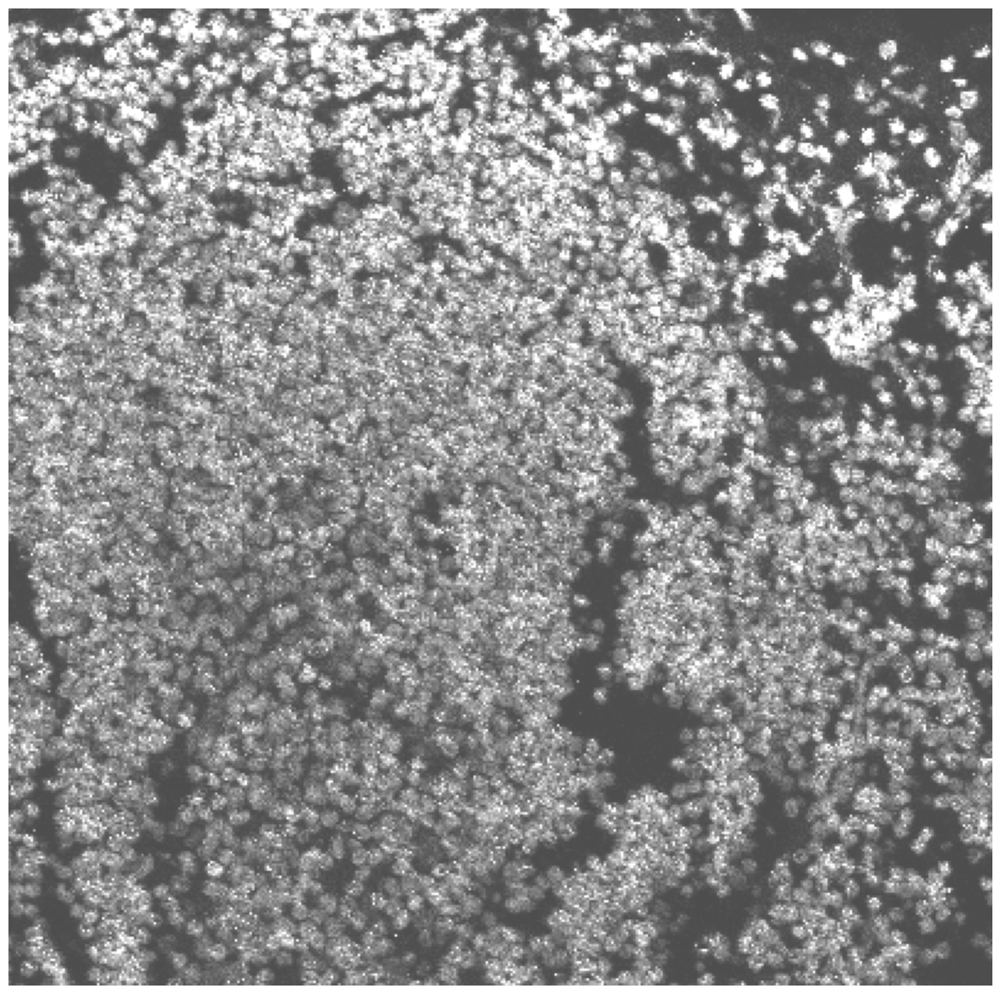

In [45]:

# Plot proximity map
fig, ax = plt.subplots(figsize=(15,15))
top, right = avg_img.shape
ax.imshow(avg_img, cmap='gray', alpha=0.7, aspect='auto', extent=[0,right,0,top], origin='lower')
ax.set_xlim([600, 1000])
ax.set_ylim([600, 1000])
ax.axis('off')
plt.show()

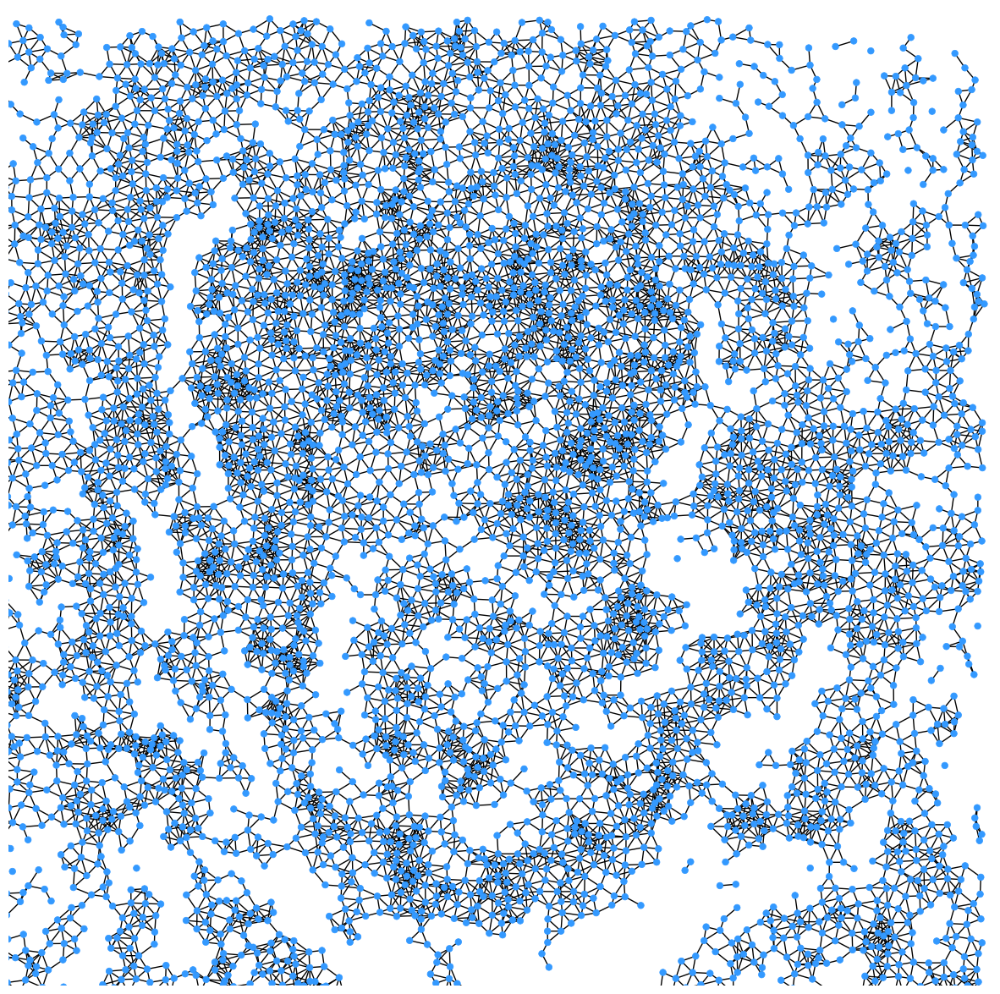

In [46]:
node_colors = [[0.2, 0.6, 1] for i in range(len(cell_labels))]

# Plot proximity map
fig, ax = plt.subplots(figsize=(15,15))
top, right = avg_img.shape
G = nx.from_numpy_array(graph)
pos = dict(zip(np.arange(len(X)), X[:,[1,0]]))
nx.draw(G, pos, node_size=30, node_color=node_colors, edge_color='black', linewidths=0.5, width=1, ax=ax)
ax = plt.gca()
ax.invert_yaxis()
ax.set_xlim([500, 1000])
ax.set_ylim([500, 1000])
plt.show()


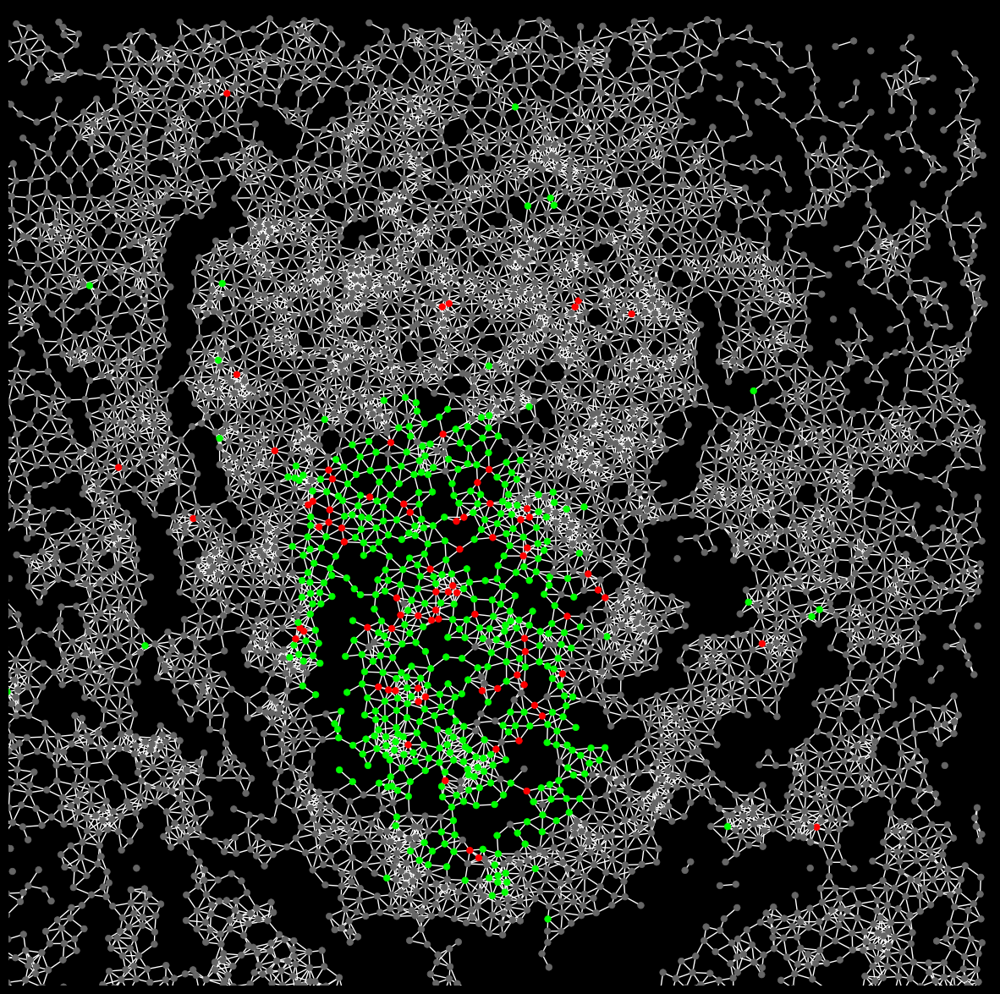

In [47]:
node_colors = [[0.4, 0.4, 0.4] for i in range(len(cell_labels))]
for i in range(len(cell_labels)): 
    if roi_labels[i] in [18]:
        node_colors[i] = [1,0,0]
    if roi_labels[i] in [9]:
        node_colors[i] = [0,1,0]

# Plot proximity map
fig, ax = plt.subplots(figsize=(15,15))
top, right = avg_img.shape
G = nx.from_numpy_array(graph)
pos = dict(zip(np.arange(len(X)), X[:,[1,0]]))
nx.draw(G, pos, node_size=30, node_color=node_colors, edge_color='white', linewidths=0.5, width=1, ax=ax)
ax = plt.gca()
ax.invert_yaxis()
ax.set_xlim([500, 1000])
ax.set_ylim([500, 1000])
ax.set_facecolor('black')
fig.set_facecolor('black')
plt.show()


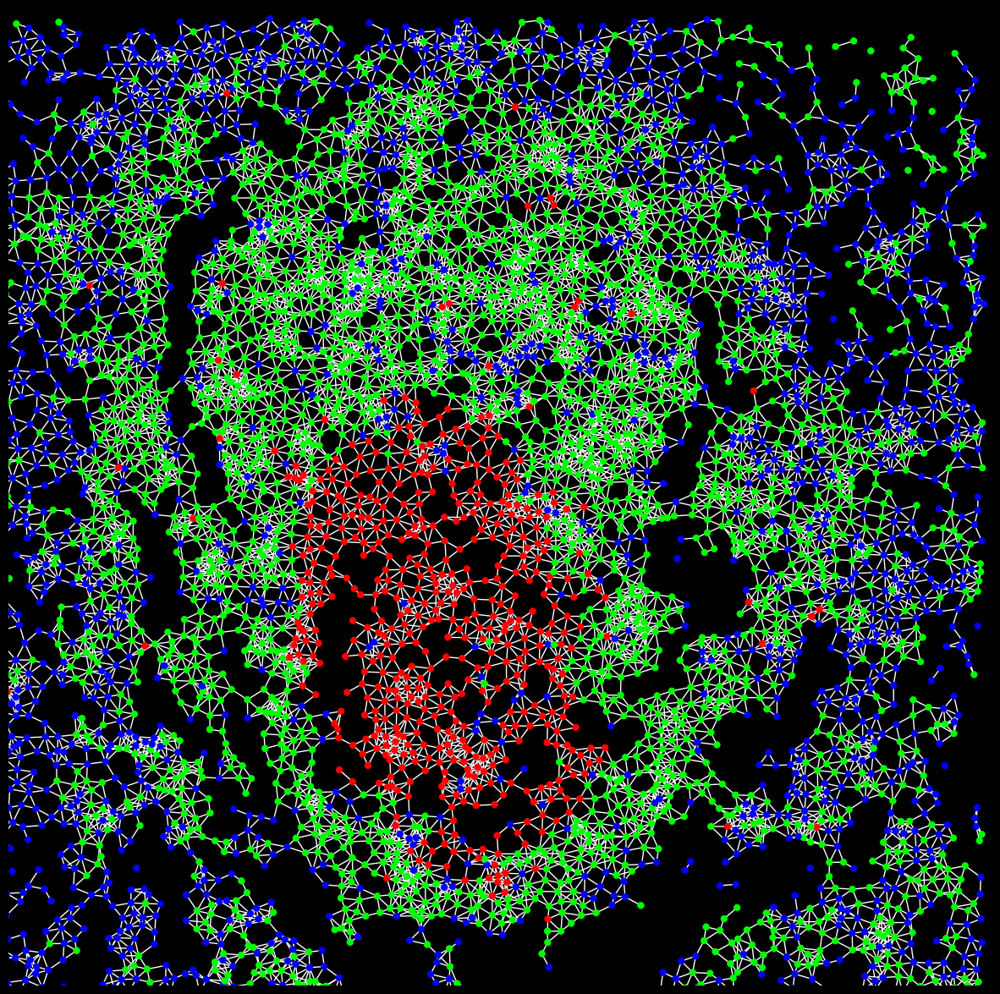

In [48]:
node_colors = [[0, 0, 1] for i in range(len(cell_labels))]
for i in range(len(cell_labels)): 
    if roi_labels[i] in [18, 9]:
        node_colors[i] = [1,0,0]
    if roi_labels[i] in [ 20, 15, 14, 11]:
        node_colors[i] = [0,1,0]

# Plot proximity map
fig, ax = plt.subplots(figsize=(15,15))
top, right = avg_img.shape
G = nx.from_numpy_array(graph)
pos = dict(zip(np.arange(len(X)), X[:,[1,0]]))
nx.draw(G, pos, node_size=30, node_color=node_colors, edge_color='white', linewidths=0.5, width=1, ax=ax)
ax = plt.gca()
ax.invert_yaxis()
ax.set_xlim([500, 1000])
ax.set_ylim([500, 1000])
ax.set_facecolor('black')
fig.set_facecolor('black')
plt.show()


In [49]:
node_colors = [my_cmap_row[roi_labels[i]] for i in range(len(cell_labels))]

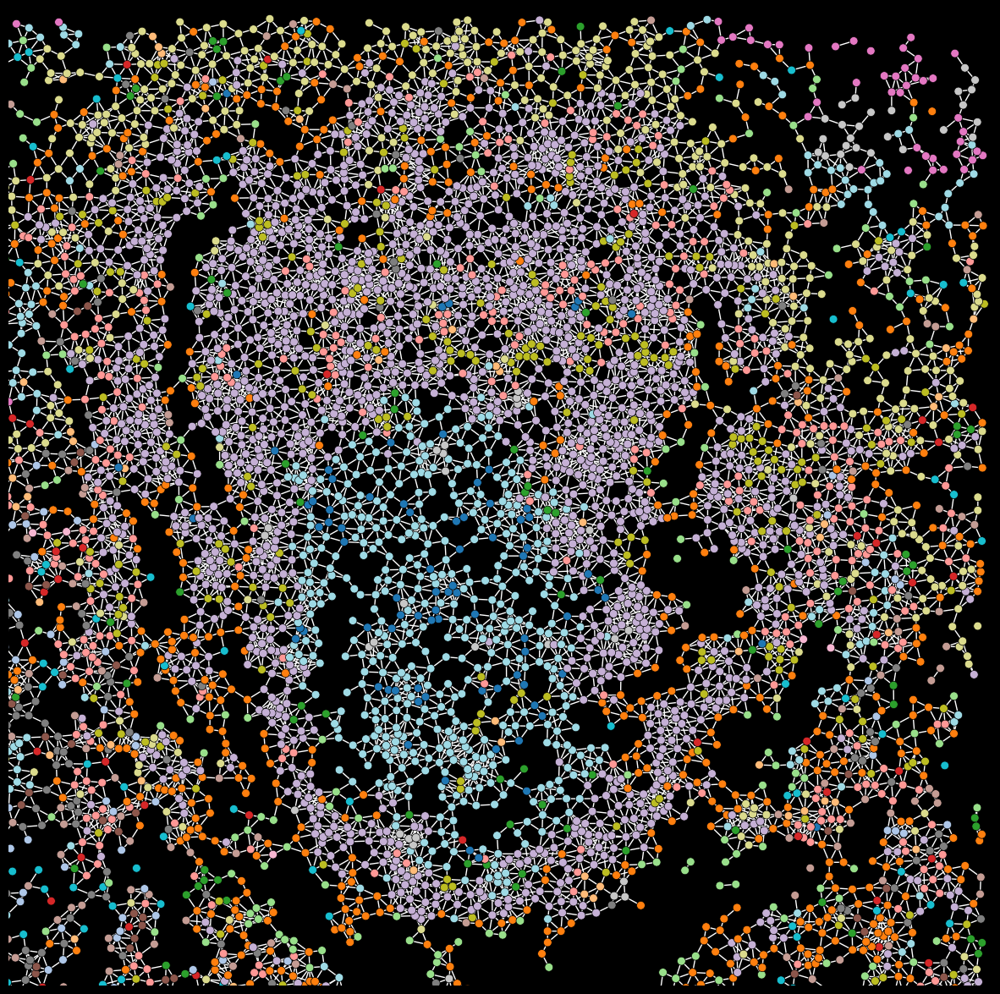

In [50]:
# Plot proximity map
fig, ax = plt.subplots(figsize=(15,15))
top, right = avg_img.shape
plot_nn(X, graph, node_colors, ax)
ax.invert_yaxis()
ax.set_xlim([500, 1000])
ax.set_ylim([500, 1000])
ax.set_facecolor('black')
fig.set_facecolor('black')
plt.show()
